## Introduction

## Install Detectron2 and dependencies

In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-95xmsut8
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-95xmsut8
  Resolved https://github.com/facebookresearch/detectron2.git to commit c39b2d04891495aeb054c7f932ec906211979586
  Preparing metadata (setup.py) ... done
  Using cached yacs-0.1.8-py3-none-any.whl (14 kB)
  Using cached fvcore-0.1.5.post20221221.tar.gz (50 kB)
  Preparing metadata (setup.py) ... done
  Using cached iopath-0.1.9-py3-none-any.whl (27 kB)
  Using cached omegaconf-2.3.0-py3-none-any.whl (79 kB)
  Using cached hydra_core-1.3.2-py3-none-any.whl (154 kB)
  Using cached black-23.3.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (1.7 MB)
  Using cached antlr4-python3-runtime-4.9.3.tar.gz (117 kB)
  Preparing metadata (setup.py) ... done
  Using c


Now is a good time to confirm that we have the right versions of the libraries at our disposal.

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [ ]:
# COMMON LIBRARIES
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

# DATA SET PREPARATION AND LOADING
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# VISUALIZATION
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

# CONFIGURATION
from detectron2 import model_zoo
from detectron2.config import get_cfg

# EVALUATION
from detectron2.engine import DefaultPredictor

# TRAINING
from detectron2.engine import DefaultTrainer

## COCO Format Dataset

### Download

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="HD0OPLHEvjhSna3fqMZq")
project = rf.workspace("new-workspace-qsuag").project("heridal-t428z")
dataset = project.version(2).download("coco",   )

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 kB 500.9 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9676 sha256=c0807640c527b1ad1bc9333d95a3970b141433f387066179246971ec00d7bfa5
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.9
    Uninstalling pyparsing-3.0.9:
      Successfully uninstalled pyparsing-3.0.9
  Attempting uninstall: idna
    Found existing installation: idna 3.4
    Uninstalling idna-3.4:
   

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Heridal-2 in coco:: 100%|██████████| 1550/1550 [00:20<00:00, 73.91it/s] 


### Register

When you use Detectron2, before you actually train the model you need to [register it](https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html#register-a-coco-format-dataset).

In [ ]:
DATA_SET_NAME = dataset.name.replace(' ', '-')
# DATA_SET_NAME = 'Heridal'
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"

In [ ]:
# TRAIN SET
TRAIN_DATA_SET_NAME = f"{DATA_SET_NAME}-train"
TRAIN_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "train")
TRAIN_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "train", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=TRAIN_DATA_SET_NAME, 
    metadata={}, 
    json_file=TRAIN_DATA_SET_ANN_FILE_PATH, 
    image_root=TRAIN_DATA_SET_IMAGES_DIR_PATH
)


# Since you don't have separate test and validation sets, 
# we will use the same train set for evaluation purposes.

# cfg.DATASETS.TEST = (TRAIN_DATA_SET_NAME,)


We can now confirm that our custom dataset was correctly registered using [MetadataCatalog](https://detectron2.readthedocs.io/en/latest/modules/data.html#detectron2.data.MetadataCatalog).

In [ ]:
[
    data_set
    for data_set
    in MetadataCatalog.list()
    if data_set.startswith(DATA_SET_NAME)
]

['Heridal-train']

### Visualize

Let's take a look at single entry from out train dataset.

Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



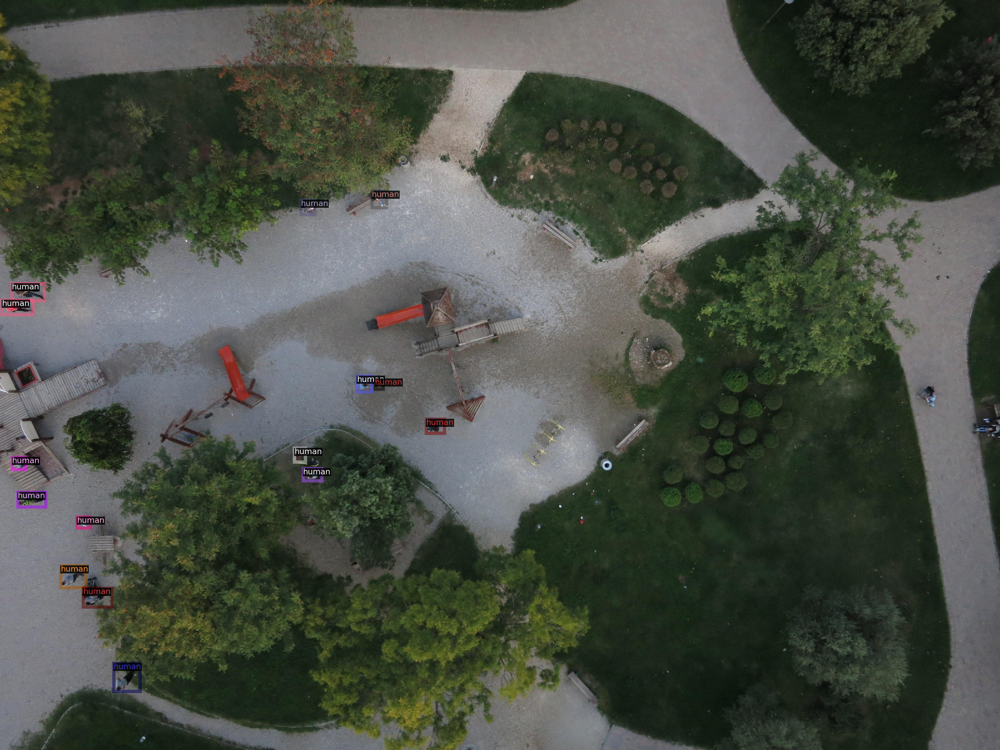

In [ ]:
metadata = MetadataCatalog.get(TRAIN_DATA_SET_NAME)
dataset_train = DatasetCatalog.get(TRAIN_DATA_SET_NAME)

dataset_entry = dataset_train[0]
image = cv2.imread(dataset_entry["file_name"])

visualizer = Visualizer(
    image[:, :, ::-1],
    metadata=metadata, 
    scale=0.8, 
    instance_mode=ColorMode.IMAGE_BW
)

out = visualizer.draw_dataset_dict(dataset_entry)
cv2_imshow(out.get_image()[:, :, ::-1])

## Train Model Using Custom COCO Format Dataset 

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

### Configuration

In [ ]:
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer

In [ ]:
# HYPERPARAMETERS
ARCHITECTURE = "retinanet_R_50_FPN_1x"
CONFIG_FILE_PATH = f"COCO-Detection/{ARCHITECTURE}.yaml"
MAX_ITER = 2000
EVAL_PERIOD = 200
BASE_LR = 0.001
NUM_CLASSES = 3

# OUTPUT DIR
OUTPUT_DIR_PATH = os.path.join(
    DATA_SET_NAME, 
    ARCHITECTURE, 
    datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
)


In [ ]:
from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = (TRAIN_DATA_SET_NAME)
cfg.DATASETS.TEST = ()

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_101_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # your number of classes (Number of foreground classes)
cfg.MODEL.RETINANET.NUM_CLASSES = 2

cfg.TEST.EVAL_PERIOD = 199


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/04 08:41:16 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
model_final_971ab9.pkl: 228MB [00:11, 19.4MB/s]                           
head.cls_score.{bias, weight}
  pixel_mean
  pixel_std


[05/04 08:41:28 d2.engine.train_loop]: Starting training from iteration 0


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)


[05/04 08:42:19 d2.utils.events]:  eta: 1:13:00  iter: 19  total_loss: 1.044  loss_cls: 0.6602  loss_box_reg: 0.3442    time: 2.3373  last_time: 1.1137  data_time: 0.8225  last_data_time: 0.0531   lr: 1.931e-06  max_mem: 4365M
[05/04 08:43:18 d2.utils.events]:  eta: 1:13:04  iter: 39  total_loss: 1.317  loss_cls: 0.8851  loss_box_reg: 0.4809    time: 2.3325  last_time: 1.7866  data_time: 1.1281  last_data_time: 0.7314   lr: 2.911e-06  max_mem: 4365M
[05/04 08:44:01 d2.utils.events]:  eta: 1:11:23  iter: 59  total_loss: 1.32  loss_cls: 0.8707  loss_box_reg: 0.4338    time: 2.2613  last_time: 1.5171  data_time: 0.9932  last_data_time: 0.2174   lr: 3.891e-06  max_mem: 4365M
[05/04 08:44:55 d2.utils.events]:  eta: 1:11:27  iter: 79  total_loss: 1.499  loss_cls: 0.9845  loss_box_reg: 0.4966    time: 2.3813  last_time: 3.0076  data_time: 1.4604  last_data_time: 1.7712   lr: 4.871e-06  max_mem: 4365M
[05/04 08:45:37 d2.utils.events]:  eta: 1:10:08  iter: 99  total_loss: 1.546  loss_cls: 0.945

### Evaluation

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import DatasetMapper, build_detection_test_loader

def limit_dataset(dataset_name, num_images):
    dataset = DatasetCatalog.get(dataset_name)
    limited_dataset = dataset[:num_images]
    DatasetCatalog.register(f"{dataset_name}_limited_34", lambda: limited_dataset)
    return f"{dataset_name}_limited_34"

def custom_build_detection_test_loader(cfg, dataset_name):
    limited_dataset_name = limit_dataset(dataset_name, 750)

    mapper = DatasetMapper(cfg, is_train=False)
    return build_detection_test_loader(cfg, limited_dataset_name, mapper=mapper)

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.NUM_CLASSES = 1
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
cfg.DATALOADER.NUM_WORKERS = 0
cfg.INPUT.MIN_SIZE_TRAIN = (640,)  # Or any smaller size you prefer
cfg.INPUT.MIN_SIZE_TEST = 640

predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("Heridal-train", cfg, False, output_dir="./output/")
val_loader = custom_build_detection_test_loader(cfg, "Heridal-train")
inference_on_dataset(trainer.model, val_loader, evaluator)


[05/04 10:00:07 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


head.cls_score.{bias, weight}


WARNING [05/04 10:00:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [05/04 10:00:07 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/04 10:00:07 d2.data.datasets.coco]: Loaded 1546 images in COCO format from /content/Heridal-2/train/_annotations.coco.json
[05/04 10:00:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(640, 640), max_size=1333, sample_style='choice')]
[05/04 10:00:07 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/04 10:00:07 d2.data.common]: Serializing 750 elements to byte tensors and concatenating them all ...
[05/04 10:00:07 d2.data.common]: Serialized dataset takes 0.20 MiB
[05/04 10:00:07 d2.evaluation.evaluator]: Start inference on 750 batches
[05/04 10:00:17 d2.eval

OrderedDict([('bbox',
              {'AP': 6.940313929589823,
               'AP50': 21.653337970063287,
               'AP75': 1.9362258437882363,
               'APs': 2.5933824151645934,
               'APm': 7.027879577172951,
               'APl': 8.160855237659854,
               'AP-Human': nan,
               'AP-human': 6.940313929589823})])

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.WEIGHTS = os.path.join('/content/Heridal/retinanet_R_50_FPN_1x/2023-05-03-21-46-43', "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.45
predictor = DefaultPredictor(cfg)

[05/04 10:18:36 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


head.cls_score.{bias, weight}


WARNING [05/04 10:33:37 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/04 10:33:37 d2.data.datasets.coco]: Loaded 1546 images in COCO format from /content/Heridal-2/train/_annotations.coco.json


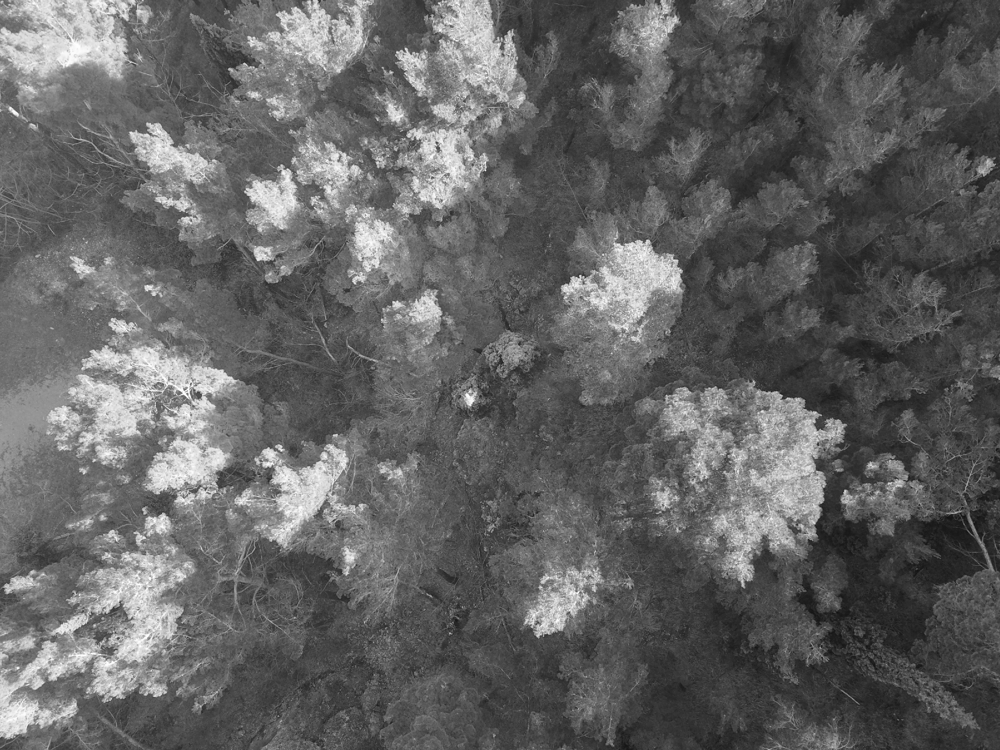

In [ ]:
dataset_valid = DatasetCatalog.get(TRAIN_DATA_SET_NAME)[0:2]

for d in dataset_valid:
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    
    visualizer = Visualizer(
        img[:, :, ::-1],
        # metadata=metadata, 
        scale=0.8, 
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# import locale
# def getpreferredencoding(do_setlocale = True):
#     return "UTF-8"
# locale.getpreferredencoding = getpreferredencoding

## По итогу:
  - Precision at IoU=0.5: 0.2165
  - Recall at IoU=0.5: 0.167
  - mAP: 0.049
  - mAP50: 0.069
  - mAP75: 0.019
  - FPS: 10.29